Installing the opencv package

In [ ]:
! pip install opencv-python, numpy

Importing the necessary packages

In [1]:
import cv2
import numpy as np
from IPython.display import display, Image

1. Sample project for Color detection

In [ ]:
def get_dominant_color(image):
    if image is None:
        raise ValueError("Invalid image provided")

    img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    pixels = img.reshape((-1, 3))

    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 200, 0.1)
    k = 5
    _, labels, centers = cv2.kmeans(pixels.astype(np.float32), k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

    # Find the most frequent color cluster
    dominant_color = centers[np.argmax(np.unique(labels, return_counts=True)[1])]
    return tuple(map(int, dominant_color))

def get_color_name(rgb_tuple):
    color_names = {
        (255, 0, 0): 'Red',
        (0, 255, 0): 'Green',
        (0, 0, 255): 'Blue',
        (0, 0, 0): 'Black',
        (255, 255, 255): 'White',
        (255, 255, 0): 'Yellow',
        (0, 255, 255): 'Cyan',
        (255, 0, 255): 'Magenta',
    }
    min_distance = float('inf')
    closest_color = None
    for color, name in color_names.items():
        distance = np.linalg.norm(np.array(rgb_tuple) - np.array(color))
        if distance < min_distance:
            min_distance = distance
            closest_color = name
    return closest_color

filename = "red.jpg"
# Read the image correctly
image = cv2.imread(filename)

if image is None:
    print("Error: Unable to load image.")
else:
    dominant_color = get_dominant_color(image)
    print("Dominant Color (RGB):", dominant_color)

    color_name = get_color_name(dominant_color)
    print(f"Detected Color: {color_name if color_name else 'Unknown'}")

Dominant Color (RGB): (253, 0, 2)
Detected Color: Red


2. Data structures for Image Analysis -Write a program that computes the T-pyramid of an image

T-Pyramid (Gaussian Pyramid)

Level 0:


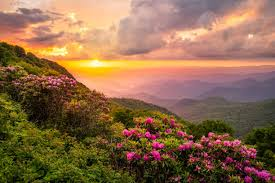


Level 1:


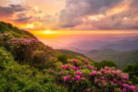


Level 2:


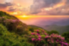


Level 3:


In [ ]:
def compute_t_pyramid(image, levels=4):
    gaussian_pyramid = [image]

    for _ in range(levels - 1):
        image = cv2.pyrDown(image)  # Downsample
        gaussian_pyramid.append(image)

    return gaussian_pyramid

def display_pyramid(pyramid, title):
    print(title)
    for i, img in enumerate(pyramid):
        print(f"\nLevel {i}:")
        
        # Convert image to PNG format for display
        _, buffer = cv2.imencode(".png", img)
        display(Image(data=buffer.tobytes()))

# Load the image
image = cv2.imread("nature.jpg")

if image is None:
    print("Error: Unable to load image.")
else:
    gaussian_pyramid = compute_t_pyramid(image, levels=4)
    display_pyramid(gaussian_pyramid, "T-Pyramid (Gaussian Pyramid)")


3. Sample project for Image Smoothing

Original Image:


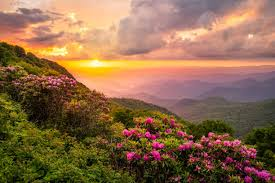

Averaging Blur:


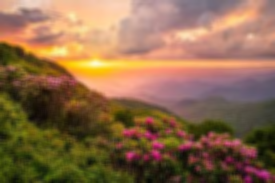

Gaussian Blur:


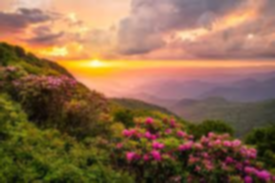

Median Blur:


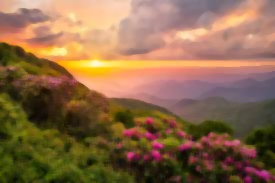

Bilateral Filter:


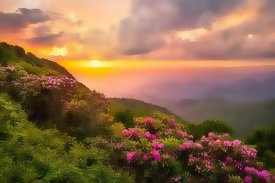

In [ ]:
# Read the image
image = cv2.imread("nature.jpg")

if image is None:
    print("Error: Unable to load image.")
else:
    average_blur = cv2.blur(image, (5, 5))
    gaussian_blur = cv2.GaussianBlur(image, (5, 5), 0)
    median_blur = cv2.medianBlur(image, 5)
    bilateral_blur = cv2.bilateralFilter(image, 9, 75, 75)

    print("Original Image:")
    _, buffer = cv2.imencode(".png", image)
    display(Image(data=buffer.tobytes()))

    print("Averaging Blur:")
    _, buffer = cv2.imencode(".png", average_blur)
    display(Image(data=buffer.tobytes()))

    print("Gaussian Blur:")
    _, buffer = cv2.imencode(".png", gaussian_blur)
    display(Image(data=buffer.tobytes()))

    print("Median Blur:")
    _, buffer = cv2.imencode(".png", median_blur)
    display(Image(data=buffer.tobytes()))

    print("Bilateral Filter:")
    _, buffer = cv2.imencode(".png", bilateral_blur)
    display(Image(data=buffer.tobytes()))


4. Sample project for Edge detection using Sobel ,Canny edge.

Original Image:


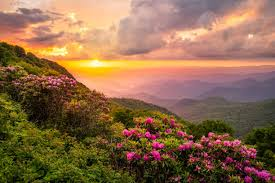

Grayscale Image:


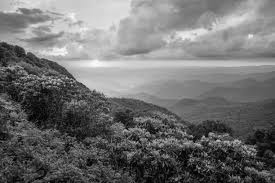

Sobel X:


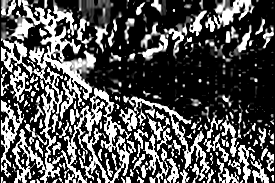

Sobel Y:


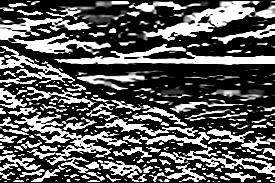

Sobel Combined:


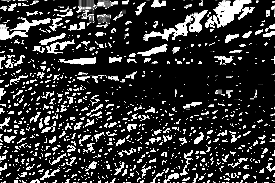

Canny Edge Detection:


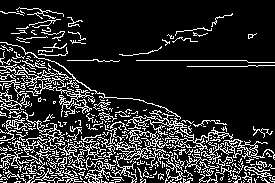

In [ ]:
# Read the image
image = cv2.imread("nature.jpg")

if image is None:
    print("Error: Unable to load image.")
else:
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply Sobel Edge Detection
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5)
    sobel_combined = cv2.bitwise_or(sobel_x, sobel_y)

    canny_edges = cv2.Canny(gray, 100, 200)

    print("Original Image:")
    _, buffer = cv2.imencode(".png", image)
    display(Image(data=buffer.tobytes()))

    print("Grayscale Image:")
    _, buffer = cv2.imencode(".png", gray)
    display(Image(data=buffer.tobytes()))

    print("Sobel X:")
    _, buffer = cv2.imencode(".png", sobel_x)
    display(Image(data=buffer.tobytes()))

    print("Sobel Y:")
    _, buffer = cv2.imencode(".png", sobel_y)
    display(Image(data=buffer.tobytes()))

    print("Sobel Combined:")
    _, buffer = cv2.imencode(".png", sobel_combined)
    display(Image(data=buffer.tobytes()))

    print("Canny Edge Detection:")
    _, buffer = cv2.imencode(".png", canny_edges)
    display(Image(data=buffer.tobytes()))


5. Object Detection with OpenCV
    Detect simple objects like faces, eyes, or hands using OpenCV and Haar cascades.
    Libraries: OpenCV, NumPy

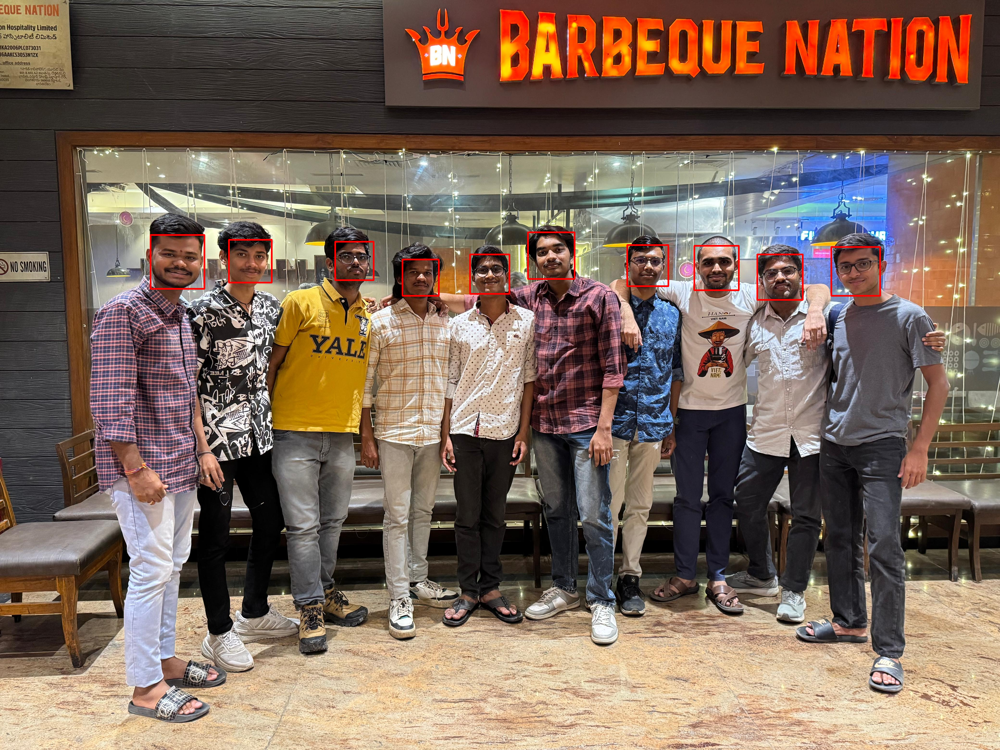

In [ ]:
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")

# Read the image
image = cv2.imread("persons.jpg")

if image is None:
    print("Error: Unable to load image.")
else:
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    gray = cv2.equalizeHist(gray)

    faces = face_cascade.detectMultiScale(
        gray,
        scaleFactor=1.1,
        minNeighbors=8,
        minSize=(120, 120)
    )

    for (x, y, w, h) in faces:
        cv2.rectangle(image, (x, y), (x + w, y + h), (0, 0, 255), 5)


    _, buffer = cv2.imencode(".png", image)
    display(Image(data=buffer.tobytes(), width=700))